# MBEN & Decoupler
Decoupler is an ensemble of methods to infer biological activity. 

Used prior knowledge: 
- Dorothea for transcription factor analysis
- Progeny for pathway analysis



  


## Init Script

In [1]:
import sys
from standard_workflows import *
import os
from copy import deepcopy
from pathlib import Path
from IPython.display import display, Markdown, Latex # to display Markdown in code chunk
import sys, logging, logging.config, random, re, json, yaml
import scanpy as sc, numpy as np, matplotlib.pyplot as plt, seaborn as sns, matplotlib as mpl, pandas as pd


# turn off warnings
import warnings

warnings.filterwarnings("ignore")

In [2]:
def print_info(analysis):
    """ Prints basic informatin about the analysis. """
    display(Markdown('**Analysis Parameters**  '))
    print(json.dumps(analysis.analysis_params['default']['decoupler'], indent=4, sort_keys=True, default=str))
    display(Markdown('**Paths**  '))
    print(json.dumps(analysis.get_paths(), indent=4, sort_keys=True, default=str))

## Init Analysis

In [3]:
# Create Dataset class. It inherits from other classes dynamically.
dc_dataset = sc_classes.Analysis.new_dataset(sc_classes.Baseanalysis, dcu.Decoupler) 
dc_dataset = sc_classes.Analysis.new_dataset(sc_classes.Baseanalysis)
# CAUTION: decoupler use_raw = True

In [7]:
# Init Analysis object
"""
            ('all_cnvsNormal', 'sn', 'human', dc_dataset)        
"""

analysis = sc_classes.Analysis(proj='MBEN_T', datasets=[
            ('all_cnvsNormal', 'sn', 'human', dc_dataset)
            ], version = 'v01', proj_path= os.path.abspath('./'))
#print_info(analysis)
scl.analysis = analysis

Data was read in from local pickle file.


AttributeError: 'str' object has no attribute 'obs'

In [30]:
# Missing Features: relAb/norm & loop over all obs of interest
# scl.plot_meta_barplots('seurat_clusters', None)

k = a.data.obsm_keys()
k

['X_harmony', 'X_pca', 'X_umap']

In [6]:
a = analysis.datasets[1]
a._paths
a.analysis_params


{'basepaths': {'basepath_local': PosixPath('/Users/hanna/Documents'),
  'basepath_bioq': PosixPath('/net/data.isilon/ag-saez/$USER'),
  'basepath_binac': PosixPath('.'),
  'storagedir': PosixPath('mounted'),
  'localdir': PosixPath('.')},
 'original_type': 'SeuratObj',
 'rename': {'clusters': 'seurat_clusters', 'subj_id': 'PID'},
 'priorKnowledge': {'dorothea': {'levels': [('A', 'B', 'C')]}},
 'decoupler': {'methods': [('mlm',)],
  'meanacts': {'groupby': ['vars'], 'minstd': 0.0},
  'pseudobulk': {'contrast': [['seurat_clusters', 'CNVs', 'Tumor', 'Normal']],
   'sumon': [['PID_CNVs', 'seurat_clusters']],
   'test': ['t-test']}},
 'liana': {'methods': [('natmi', 'connectome', 'logfc', 'sca', 'cellphonedb')],
  'base': 'exp(1)',
  'lig_rec': [('all',)]}}

In [7]:
#import decoupler as d

#d.decouple(analysis.datasets[2].data, model, methods=['mlm'])

#d.decouple(analysis.datasets[0].data, model, methods=['mlm'], consensus = False, use_raw = True)
#analysis.datasets[0].data.obsm['mlm_pvals'].loc[:, ['GLI1']]

In [8]:
#d.decouple(analysis.datasets[0].data, model, methods=['mlm'], consensus = False, use_raw = False)
#analysis.datasets[0].data.obsm['mlm_pvals'].loc[:, ['GLI1']]

In [9]:
#d.decouple(analysis.datasets[0].data, model, methods=['mlm'], consensus = False, use_raw = False, min_n=2)
#analysis.datasets[0].data.obsm['mlm_pvals'].loc[:, ['GLI1']]

In [10]:
#ds = analysis.datasets[0]
#act = ds.acts[1]
#act = act.data.obsm['dorotheaabc_mlm_pvals']
#act
#act.loc[:, ['GLI3']]

In [11]:
#'GLI1' in list(model.source)
#model.loc[model['source'] == 'GLI1']

# Get_subsets

In [12]:
#scl.get_subsets(dc_dataset)


# Save Paths

In [13]:
def save_paths(self):
    """ Saves analysis params together with paths to yaml file. """
    self.analysis_params['default']['paths'] = self.get_paths()
    with open(self.get_paths()['analysispath_local'] / 'analysis_params_paths.yaml', 'w+') as file:
        yaml.dump(self.analysis_params, file)
    for data in self.datasets:
        data.analysis_params['paths'] = data._paths
        print(data._paths)
        with open(data._paths['analysispath_local'] / data._paths['datasetpath'] / 'analysis_params.yaml', 'w+') as file:
            yaml.dump(data.analysis_params, file)



In [14]:
save_paths(analysis)

{'basepath_local': PosixPath('/Users/hanna/Documents'), 'basepath_bioq': PosixPath('/net/data.isilon/ag-saez/$USER'), 'basepath_binac': PosixPath('.'), 'storagedir': PosixPath('mounted'), 'localdir': PosixPath('.'), 'analysisversion': 'v01', 'storagepath_hpc': PosixPath('~/../../mnt/sds-hd/sd22b002'), 'storagepath_local': PosixPath('/Users/hanna/Documents/mounted/projects/MBEN'), 'analysispath_local': PosixPath('/Users/hanna/Documents/projects/MBEN'), 'datapath': PosixPath('/Users/hanna/Documents/mounted/projects/MBEN/v01/human/sn/all/data'), 'scriptpath': PosixPath('/Users/hanna/Documents/projects/MBEN/scripts'), 'figpath': PosixPath('/Users/hanna/Documents/projects/MBEN/v01/human/sn/all/figures'), 'logpath': PosixPath('/Users/hanna/Documents/projects/MBEN/v01/human/sn/all/log'), 'resultpath': PosixPath('/Users/hanna/Documents/projects/MBEN/v01/human/sn/all/results'), 'priorKnowledge': PosixPath('/Users/hanna/Documents/mounted/projects/MBEN/data/priorKnowledge'), 'datasetpath': PosixP

In [52]:
#import decoupler as d
#model = d.get_dorothea(levels = ['A', 'B', 'C'])
m = model.loc[model['source'] == 'GLI2']
print(m)

data = analysis.datasets[0].data

print(data.var_names)

print("BCL2" in data.var_names)
print("CCND1" in data.var_names)
print("COL5A2" in data.var_names)
print("EFEMP1" in data.var_names)
print("FAS" in data.var_names)
print("FGF13" in data.var_names)
print("FOXA2" in data.var_names)
print("FOXE1" in data.var_names)
print("IFNGR1" in data.var_names)
print("LUM" in data.var_names)



    source confidence  target  weight
62    GLI2          A    GLI1     1.0
71    GLI2          A    BCL2     1.0
73    GLI2          A   CCND1     1.0
102   GLI2          A  COL5A2     1.0
207   GLI2          A  EFEMP1    -1.0
339   GLI2          A     FAS    -1.0
340   GLI2          A   FGF13     1.0
341   GLI2          A   FOXA2     1.0
345   GLI2          A   FOXE1     1.0
347   GLI2          A     FST     1.0
348   GLI2          A  IFNGR1    -1.0
351   GLI2          A     LUM    -1.0
352   GLI2          A    PCNA     1.0
353   GLI2          A   PTCH1     1.0
357   GLI2          A    UGCG    -1.0
358   GLI2          A   WNT2B     1.0
Index(['AJAP1', 'DHRS3', 'GRHL3', 'GRIK3', 'SLC5A9', 'RP11-436K8.1',
       'ST6GALNAC5', 'PTGFR', 'COL24A1', 'TGFBR3',
       ...
       'SHFM1P1', 'RP3-340B19.2', 'RP4-668E10.2', 'AC092013.1', 'TDPX2',
       'RP11-676F20.1', 'RP11-116N8.4', 'RP11-310H4.3', 'RP11-863K10.7',
       'CTD-3224I3.3'],
      dtype='object', length=2000)
True
False
False
T

In [51]:
print(data.raw.var_names)

print("BCL2" in data.raw.var_names)
print("CCND1" in data.raw.var_names)
print("COL5A2" in data.raw.var_names)
print("EFEMP1" in data.raw.var_names)
print("FAS" in data.raw.var_names)
print("FGF13" in data.raw.var_names)
print("FOXA2" in data.raw.var_names)
print("FOXE1" in data.raw.var_names)
print("IFNGR1" in data.raw.var_names)
print("LUM" in data.raw.var_names)

Index(['RP4-669L17.10', 'RP5-857K21.4', 'RP11-206L10.9', 'NOC2L', 'KLHL17',
       'HES4', 'AGRN', 'C1orf159', 'SDF4', 'B3GALT6',
       ...
       'RP11-460N11.3', 'RP11-9M16.2', 'CTD-3224I3.3', 'LINC00552',
       'RP11-707O23.5', 'RP11-259G18.3', 'CTD-2639E6.9', 'RP4-705O1.1', 'LIF',
       'LL22NC03-121E8.4'],
      dtype='object', length=29915)
True
True
True
True
True
True
False
True
True
True


## Decoupler  
### Activity estimates  
For each dataset the activities are estimated according to the given prior knowledge and decoupler parameters. 

In [29]:
#%%asmarkdown
scl.get_acts()



#import decoupler as d
#d.run_consensus(analysis.datasets[1].data)
#data = analysis.datasets[0]
#a = data.acts[2]
#c = d.decouple(analysis.datasets[0].data, d.get_dorothea())

** all_t_clust43102_subjAK1 **  
Prior Knowledge was read in from pickle files.
Activity calculation starts for modeltype **dorothea** with parameter **('A', 'B', 'C')** and method **('mlm',)**
7084 features of mat are empty in 5469 samples, they will be ignored.
Running mlm on mat with 5472 samples and 22831 targets for 295 sources.


100%|██████████| 1/1 [00:05<00:00,  5.64s/it]




** all_t_clust43102_subjAK2 **  
Prior Knowledge was read in from pickle files.
Activity calculation starts for modeltype **dorothea** with parameter **('A', 'B', 'C')** and method **('mlm',)**
15575 features of mat are empty in 148 samples, they will be ignored.
Running mlm on mat with 151 samples and 14340 targets for 282 sources.


100%|██████████| 1/1 [00:00<00:00,  5.96it/s]




** all_t_clust43102_subjAK3 **  
Prior Knowledge was read in from pickle files.
Activity calculation starts for modeltype **dorothea** with parameter **('A', 'B', 'C')** and method **('mlm',)**
4950 features of mat are empty in 3610 samples, they will be ignored.
Running mlm on mat with 3613 samples and 24965 targets for 295 sources.


100%|██████████| 1/1 [00:03<00:00,  3.92s/it]




** all_t_clust43102_subjMB263 **  
Prior Knowledge was read in from pickle files.
Activity calculation starts for modeltype **dorothea** with parameter **('A', 'B', 'C')** and method **('mlm',)**
3459 features of mat are empty in 2778 samples, they will be ignored.
Running mlm on mat with 2781 samples and 26456 targets for 297 sources.


100%|██████████| 1/1 [00:03<00:00,  3.27s/it]




** all_t_clust43102_subjMB266 **  
Prior Knowledge was read in from pickle files.
Activity calculation starts for modeltype **dorothea** with parameter **('A', 'B', 'C')** and method **('mlm',)**
2663 features of mat are empty in 2333 samples, they will be ignored.
Running mlm on mat with 2336 samples and 27252 targets for 297 sources.


100%|██████████| 1/1 [00:02<00:00,  2.86s/it]




** all_t_clust43102_subjMB287 **  
Prior Knowledge was read in from pickle files.
Activity calculation starts for modeltype **dorothea** with parameter **('A', 'B', 'C')** and method **('mlm',)**
7506 features of mat are empty in 3541 samples, they will be ignored.
Running mlm on mat with 3544 samples and 22409 targets for 293 sources.


100%|██████████| 1/1 [00:03<00:00,  3.55s/it]




** all_t_clust43102_subjMB295 **  
Prior Knowledge was read in from pickle files.
Activity calculation starts for modeltype **dorothea** with parameter **('A', 'B', 'C')** and method **('mlm',)**
5433 features of mat are empty in 3622 samples, they will be ignored.
Running mlm on mat with 3625 samples and 24482 targets for 296 sources.


100%|██████████| 1/1 [00:03<00:00,  3.92s/it]




** all_t_clust43102_subjMB299 **  
Prior Knowledge was read in from pickle files.
Activity calculation starts for modeltype **dorothea** with parameter **('A', 'B', 'C')** and method **('mlm',)**
4915 features of mat are empty in 4902 samples, they will be ignored.
Running mlm on mat with 4905 samples and 25000 targets for 296 sources.


100%|██████████| 1/1 [00:05<00:00,  5.80s/it]




** all_t_clust43102_subjMB88 **  
Prior Knowledge was read in from pickle files.
Activity calculation starts for modeltype **dorothea** with parameter **('A', 'B', 'C')** and method **('mlm',)**
10816 features of mat are empty in 893 samples, they will be ignored.
Running mlm on mat with 896 samples and 19099 targets for 290 sources.


100%|██████████| 1/1 [00:00<00:00,  1.27it/s]




** all_cnvsNormal **  
Prior Knowledge was read in from pickle files.
Activity calculation starts for modeltype **dorothea** with parameter **('A', 'B', 'C')** and method **('mlm',)**
8889 features of mat are empty in 976 samples, they will be ignored.
Running mlm on mat with 979 samples and 21026 targets for 294 sources.


100%|██████████| 1/1 [00:00<00:00,  1.05it/s]


In [30]:
scl.plot_umap()

## Estimated activities for all_t_clust43102_subjAK1

dorothea with parameter ('A', 'B', 'C') and method ('mlm', 'mlm').

## Estimated activities for all_t_clust43102_subjAK2

dorothea with parameter ('A', 'B', 'C') and method ('mlm', 'mlm').

## Estimated activities for all_t_clust43102_subjAK3

dorothea with parameter ('A', 'B', 'C') and method ('mlm', 'mlm').

## Estimated activities for all_t_clust43102_subjMB263

dorothea with parameter ('A', 'B', 'C') and method ('mlm', 'mlm').

## Estimated activities for all_t_clust43102_subjMB266

dorothea with parameter ('A', 'B', 'C') and method ('mlm', 'mlm').

## Estimated activities for all_t_clust43102_subjMB287

dorothea with parameter ('A', 'B', 'C') and method ('mlm', 'mlm').

## Estimated activities for all_t_clust43102_subjMB295

dorothea with parameter ('A', 'B', 'C') and method ('mlm', 'mlm').

## Estimated activities for all_t_clust43102_subjMB299

dorothea with parameter ('A', 'B', 'C') and method ('mlm', 'mlm').

## Estimated activities for all_t_clust43102_subjMB88

dorothea with parameter ('A', 'B', 'C') and method ('mlm', 'mlm').

## Estimated activities for all_cnvsNormal

dorothea with parameter ('A', 'B', 'C') and method ('mlm', 'mlm').

### Mean Activities
For each calculated activity the mean activity values are calculated. 

In [31]:
#%%asmarkdown
scl.get_mean_acts()


** all_t_clust43102_subjAK1 **  
- *dorothea* -
orig.ident
nCount_RNA
nFeature_RNA
percent.mito
clusters_anno
tech
PID
S.Score
G2M.Score
Phase
RNA_snn_res.0.2
seurat_clusters
CNVs
Doublet_score
labels

** all_t_clust43102_subjAK2 **  
- *dorothea* -
orig.ident
nCount_RNA
nFeature_RNA
percent.mito
clusters_anno
tech
PID
S.Score
G2M.Score
Phase
RNA_snn_res.0.2
seurat_clusters
CNVs
Doublet_score
labels

** all_t_clust43102_subjAK3 **  
- *dorothea* -
orig.ident
nCount_RNA
nFeature_RNA
percent.mito
clusters_anno
tech
PID
S.Score
G2M.Score
Phase
RNA_snn_res.0.2
seurat_clusters
CNVs
Doublet_score
labels

** all_t_clust43102_subjMB263 **  
- *dorothea* -
orig.ident
nCount_RNA
nFeature_RNA
percent.mito
clusters_anno
tech
PID
S.Score
G2M.Score
Phase
RNA_snn_res.0.2
seurat_clusters
CNVs
Doublet_score
labels

** all_t_clust43102_subjMB266 **  
- *dorothea* -
orig.ident
nCount_RNA
nFeature_RNA
percent.mito
clusters_anno
tech
PID
S.Score
G2M.Score
Phase
RNA_snn_res.0.2
seurat_clusters
CNVs
Doublet

###  all_t_clust43102_subjAK1
Mean acts are plotted for dorothea('A', 'B', 'C').  



###  all_t_clust43102_subjAK2
Mean acts are plotted for dorothea('A', 'B', 'C').  



###  all_t_clust43102_subjAK3
Mean acts are plotted for dorothea('A', 'B', 'C').  



###  all_t_clust43102_subjMB263
Mean acts are plotted for dorothea('A', 'B', 'C').  



###  all_t_clust43102_subjMB266
Mean acts are plotted for dorothea('A', 'B', 'C').  



###  all_t_clust43102_subjMB287
Mean acts are plotted for dorothea('A', 'B', 'C').  



###  all_t_clust43102_subjMB295
Mean acts are plotted for dorothea('A', 'B', 'C').  



###  all_t_clust43102_subjMB299
Mean acts are plotted for dorothea('A', 'B', 'C').  



###  all_t_clust43102_subjMB88
Mean acts are plotted for dorothea('A', 'B', 'C').  



###  all_cnvsNormal
Mean acts are plotted for dorothea('A', 'B', 'C').  





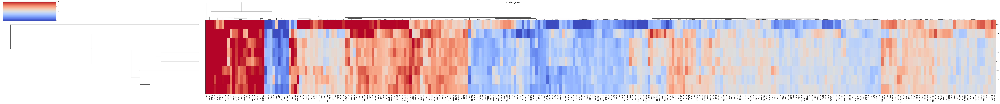

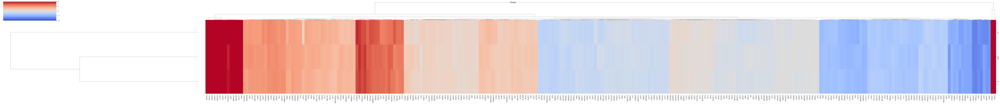

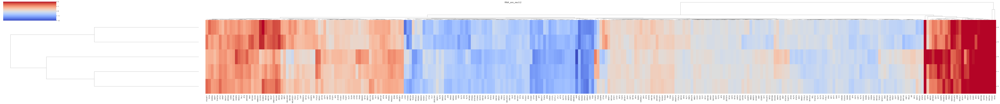

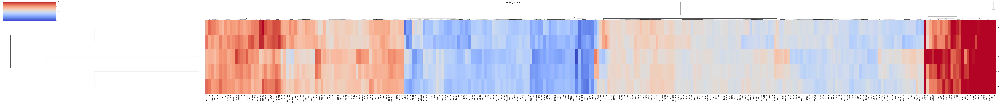

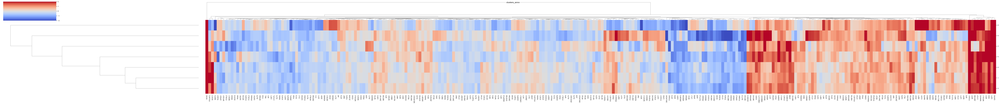

...

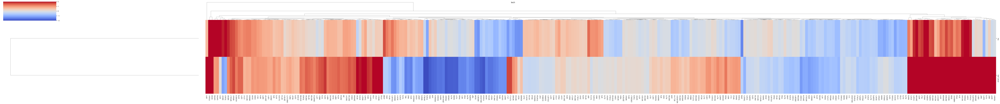

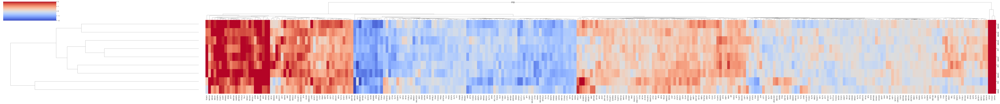

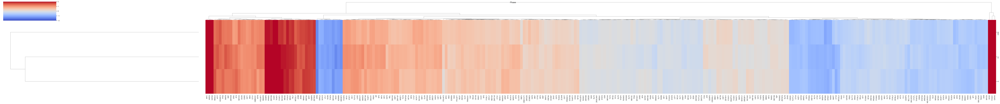

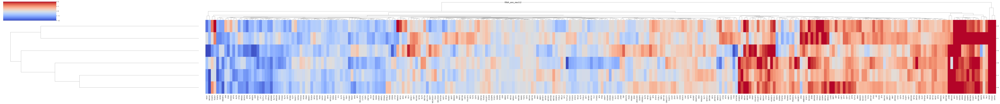

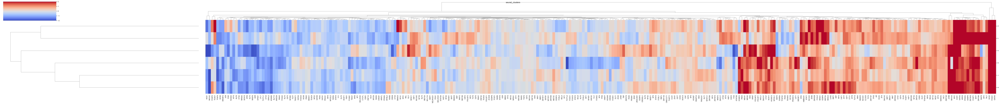

In [32]:
#%%asmarkdown
scl.plot_mean_acts()


In [15]:
import os
import shutil

dir_name = "/Users/hanna/Documents/projects/MBEN/v01/sent/v01_sent220901/"

def delete_files(dir_name):
    all_subdir_names = ''
    if os.path.isdir(dir_name):
        all_subdir_names = os.listdir(dir_name)
        print(all_subdir_names)
        if len(all_subdir_names) >= 1:
            for elem in all_subdir_names:
                match = re.match("^.*(h5ad|DS_Store|pickle|priorKnowledge|data|analysis_params.yaml)", elem)
                if match != None:
                    if os.path.isdir(os.path.join(dir_name, elem)) : 
                        shutil.rmtree(os.path.join(dir_name, elem))  
                        print('this gets deleted: ', elem)
                    else: 
                        os.remove(os.path.join(dir_name, elem))
                         
                        print('this gets deleted: ', elem)
                else :
                    print('new iteration with: ', os.path.join(dir_name, elem))
                    print(delete_files(os.path.join(dir_name, elem)))

delete_files(dir_name)

['priorKnowledge', '.DS_Store', 'all_t_clust43102_subjMB295', 'all_t_clust43102_subjMB266', 'all_t_clust43102_subjMB88', 'all_t_clust43102_subjMB287', 'all_t_clust43102_subjAK1', 'all_t', 'all', '1120_1101to9', 'all_t_clust43102_subjMB299', 'all_t_clust43102_subjMB263', 'all_t_clust43102', 'all_t_clust43102_subjAK2', 'all_t_clust43102_subjAK3', 'all_cnvsNormal']
this gets deleted:  priorKnowledge
this gets deleted:  .DS_Store
new iteration with:  /Users/hanna/Documents/projects/MBEN/v01/sent/v01_sent220901/all_t_clust43102_subjMB295
['analysis_params.yaml', 'results', 'figures', 'data']
this gets deleted:  analysis_params.yaml
new iteration with:  /Users/hanna/Documents/projects/MBEN/v01/sent/v01_sent220901/all_t_clust43102_subjMB295/results
['log']
new iteration with:  /Users/hanna/Documents/projects/MBEN/v01/sent/v01_sent220901/all_t_clust43102_subjMB295/results/log
['decoupler', 'liana']
new iteration with:  /Users/hanna/Documents/projects/MBEN/v01/sent/v01_sent220901/all_t_clust431

In [33]:
dir_name = "/Users/hanna/Documents/projects/MBEN/v01_copy/human/sn.h5ad/.DS_Store"
print(re.match("^.*[.h5ad|.DS_Store]", dir_name)[0])

/Users/hanna/Documents/projects/MBEN/v01_copy/human/sn.h5ad/.DS_Store
